## Portfolio Analysis 

This notebook contains the financial analysis and visualizations required to answer our research questions. The goal of this notebook is to analyze the profitable portfolio delivered by the algorithm found in the [Portfolio Data Builder](portfolio_data_builder.ipynb). 

### Financial Performance Indicators Analyzed;
1 Portfolio weight distribution

2 Portfolio returns

3 Cumulative returns

4 Rolling volatility 

5 Monte Carlo Simulation

6 Sharpe Ratio

7 Sortino Ratio 


Note: Two visualizations were generated to better understand the use of the trading algorithm employed; an HV line plot and a plotly express line plot for Amazon simple move average crossover. 


### Imports

In [1]:
# Initial imports 
import os
import datetime as dt
import pandas as pd
import numpy as np
import datetime as dt
import matplotlib

%matplotlib inline

import matplotlib.pyplot as plt
import panel as pn
import plotly.express as px
from pathlib import Path

In [2]:
# Initialize the Panel Extensions (for Plotly)
pn.extension("plotly")

In [3]:
# Import hvplot.pandas after pn.extension
import hvplot.pandas

In [4]:
# Set the random seed for resutls reproducibility (for testing purposes only)
np.random.seed(42)

## Research Question 1: Portfolio Analysis

Based on the defined strategy applied to the S&P 500 stocks, what are the top ten companies returning the highest profit?

### Reading in the CSV data

The first table displays the top ten stocks comprising the Profitable Portfolio. The algorithm used to determine the stocks in this portfolio can be found in the "profitable_portfolio" notebook. 

In [5]:
# Read in the proftiable portfolio csv
profitable_portfolio_df = Path("resources/top_profitable_stock.csv")
profitable_portfolio_df = pd.read_csv(profitable_portfolio_df)

# Remove the uncessessary columns
profitable_portfolio_df = profitable_portfolio_df.drop(columns=["Unnamed: 0"])

# Display the df
profitable_portfolio_df


,symbol,profit,sector
0,AMZN,791870.0,Consumer Discretionary
1,BIO,512990.0,Health Care
2,NOW,315080.0,Information Technology
3,MSCI,309330.0,Financials
4,IPGP,265020.0,Information Technology
5,SPGI,247000.0,Financials
6,NFLX,242020.0,Communication Services
7,TDY,182080.0,Industrials
8,PNC,181710.0,Financials
9,MKTX,176950.0,Financials


In [6]:
# Read in the portfolio closing prices csv
portfolio_close_prices_df = Path("resources/top_prof_stock_prices.csv")
portfolio_close_prices_df = pd.read_csv(portfolio_close_prices_df, 
                                        index_col="date", 
                                        infer_datetime_format=True, 
                                        parse_dates=True)



# Display the df
portfolio_close_prices_df.head()


,SPY,MKTX,PNC,TDY,NFLX,SPGI,IPGP,MSCI,NOW,BIO,AMZN
date,,,,,,,,,,,
2015-07-27,206.79,97.95,97.51,102.67,106.43,99.59,79.86,65.73,76.34,146.45,531.41
2015-07-28,209.33,97.66,98.14,103.67,106.90,98.40,89.71,66.00,78.63,149.45,526.03
2015-07-29,210.77,98.16,98.55,104.99,107.08,101.48,93.30,66.91,77.98,150.46,529.00
2015-07-30,210.82,97.07,98.67,103.70,111.56,102.84,92.56,67.97,81.03,150.81,536.76
2015-07-31,210.50,97.80,98.18,103.67,114.31,101.75,92.22,68.16,80.50,150.74,536.15


### Portfolio Returns 

In [7]:
# Calculate the daily returns from the closing prices 
portfolio_daily_returns = portfolio_close_prices_df.pct_change()

# Display the returns 
portfolio_daily_returns.head()

,SPY,MKTX,PNC,TDY,NFLX,SPGI,IPGP,MSCI,NOW,BIO,AMZN
date,,,,,,,,,,,
2015-07-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-07-28,0.012283,-0.002961,0.006461,0.009740,0.004416,-0.011949,0.123341,0.004108,0.029997,0.020485,-0.010124
2015-07-29,0.006879,0.005120,0.004178,0.012733,0.001684,0.031301,0.040018,0.013788,-0.008267,0.006758,0.005646
2015-07-30,0.000237,-0.011104,0.001218,-0.012287,0.041838,0.013402,-0.007931,0.015842,0.039113,0.002326,0.014669
2015-07-31,-0.001518,0.007520,-0.004966,-0.000289,0.024650,-0.010599,-0.003673,0.002795,-0.006541,-0.000464,-0.001136


### Average Daily Portfolio Returns 

In [8]:
#calculate mean of daily returns
avg_daily_return = portfolio_daily_returns.mean()
avg_daily_return

SPY     0.000422
MKTX    0.001499
PNC     0.000264
TDY     0.001057
NFLX    0.001541
SPGI    0.001155
IPGP    0.000995
MSCI    0.001594
NOW     0.001666
BIO     0.001159
AMZN    0.001558
dtype: float64

### Standard Deviation of Daily Returns for Portfolio

In [9]:
std_dev_daily_return = portfolio_daily_returns.std()
std_dev_daily_return

SPY     0.012051
MKTX    0.019698
PNC     0.019529
TDY     0.018821
NFLX    0.026188
SPGI    0.017602
IPGP    0.027010
MSCI    0.019343
NOW     0.024486
BIO     0.018000
AMZN    0.018964
dtype: float64

In [10]:
# Create a line plot using hvplot for portfolio returns

hvlineplot_portfolioreturns = portfolio_daily_returns.hvplot(label="Proftiable Portfolio Returns",
                                                       legend=True,
                                                       height=500,
                                                       width=900)

# Display the line plot for portfolio returns
hvlineplot_portfolioreturns


:NdOverlay   [Variable]
   :Curve   [date]   (value)

### Portfolio Cumulative Returns

In [11]:
# Calculate the portfolio's cumulative returns
cumulative_returns = (1 + portfolio_daily_returns).cumprod() - 1

# Display the cumulative returns
cumulative_returns.head()


,SPY,MKTX,PNC,TDY,NFLX,SPGI,IPGP,MSCI,NOW,BIO,AMZN
date,,,,,,,,,,,
2015-07-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2015-07-28,0.012283,-0.002961,0.006461,0.009740,0.004416,-0.011949,0.123341,0.004108,0.029997,0.020485,-0.010124
2015-07-29,0.019247,0.002144,0.010666,0.022597,0.006107,0.018978,0.168295,0.017952,0.021483,0.027381,-0.004535
2015-07-30,0.019488,-0.008984,0.011896,0.010032,0.048201,0.032634,0.159028,0.034079,0.061436,0.029771,0.010068
2015-07-31,0.017941,-0.001531,0.006871,0.009740,0.074039,0.021689,0.154771,0.036969,0.054493,0.029293,0.008920


In [12]:
# Create a line plot using hvplot for cumulative returns
hvlineplot_cumulative_returns = cumulative_returns.hvplot(label="Proftiable Portfolio Cumulative Returns",
                                                                    legend=True,
                                                                    height=500,
                                                                    width=900)

# Display the line plot for portfolio returns
hvlineplot_cumulative_returns

:NdOverlay   [Variable]
   :Curve   [date]   (value)

#### Portfolio performance against the S&P 500

It appears 90% of the stocks in the Profitable Portfolio outperform the S&P 500. One performer that appears to follow the S&P 500 closely is PNC Financial Services Group (ticker: PNC). 

### Profitability Distribution

This visualization displays the profit distribution in the Profitable Portfolio

In [13]:
# Use the proftiable_portfolio_df dataset to create a proftiability distribution pie chart
profitable_portfolio_df

,symbol,profit,sector
0,AMZN,791870.0,Consumer Discretionary
1,BIO,512990.0,Health Care
2,NOW,315080.0,Information Technology
3,MSCI,309330.0,Financials
4,IPGP,265020.0,Information Technology
5,SPGI,247000.0,Financials
6,NFLX,242020.0,Communication Services
7,TDY,182080.0,Industrials
8,PNC,181710.0,Financials
9,MKTX,176950.0,Financials


In [14]:
# Create a pie graph using the plotly express function 
profitability_distribution_piechart = px.pie(profitable_portfolio_df,
                                values="profit",
                                names="symbol",
                                title="Portfolio Profitability Distribution")
                                
# Display the pie chart
profitability_distribution_piechart.show()

In [15]:
# Sunburst chart displaying the profit distribution

profit_distribution_sunburstchart = px.sunburst(profitable_portfolio_df, 
                                                path = ["sector", "symbol"],
                                                values = "profit",
                                                hover_data = ["sector"],
                                                color = "profit",
                                                color_continuous_scale="ice",
                                                title="Profit Distribution in the Profitable Portfolio")


profit_distribution_sunburstchart




### Determining the weights in the Profitable Portfolio

In [16]:
# Calculate the weights of each stock in the Profitable Portfolio

# Index the profitable_portfolio_df 
profitable_portfolio = profitable_portfolio_df.set_index("symbol")

# Display the new dataset 
profitable_portfolio

,profit,sector
symbol,,
AMZN,791870.0,Consumer Discretionary
BIO,512990.0,Health Care
NOW,315080.0,Information Technology
MSCI,309330.0,Financials
IPGP,265020.0,Information Technology
SPGI,247000.0,Financials
NFLX,242020.0,Communication Services
TDY,182080.0,Industrials
PNC,181710.0,Financials


In [17]:
# Calculate the stock weights 
profitable_portfolio_sum = sum(profitable_portfolio['profit'])
weighted_profitable_portfolio = profitable_portfolio['profit'] / profitable_portfolio_sum

# Display the weighted dataset
weighted_profitable_portfolio


symbol
AMZN    0.245613
BIO     0.159114
NOW     0.097728
MSCI    0.095945
IPGP    0.082201
SPGI    0.076612
NFLX    0.075067
TDY     0.056476
PNC     0.056361
MKTX    0.054884
Name: profit, dtype: float64

### Monte Carlo Simulation with the results saved to DataFrame

In [18]:
# Read in the csv Top Profitable Stock Prices "top_prof_stock_prices.csv"
top_prof_stock_prices_df = Path("resources/top_prof_stock_prices.csv")


# # Adjust the df to display the required data
top_prof_stock_prices_df = pd.read_csv(top_prof_stock_prices_df, index_col="date", parse_dates=True, infer_datetime_format=True)
top_prof_stock_prices_df.sort_index(inplace = True)

top_prof_stock_prices_df.head()

,SPY,MKTX,PNC,TDY,NFLX,SPGI,IPGP,MSCI,NOW,BIO,AMZN
date,,,,,,,,,,,
2015-07-27,206.79,97.95,97.51,102.67,106.43,99.59,79.86,65.73,76.34,146.45,531.41
2015-07-28,209.33,97.66,98.14,103.67,106.90,98.40,89.71,66.00,78.63,149.45,526.03
2015-07-29,210.77,98.16,98.55,104.99,107.08,101.48,93.30,66.91,77.98,150.46,529.00
2015-07-30,210.82,97.07,98.67,103.70,111.56,102.84,92.56,67.97,81.03,150.81,536.76
2015-07-31,210.50,97.80,98.18,103.67,114.31,101.75,92.22,68.16,80.50,150.74,536.15


In [19]:
# Set number of simulations, trading days, and get last closing price of portfolio
num_simulations = 1000
num_trading_days = 252*15

# Set last closing prices of stocks within portfolio
amzn_last_price = top_prof_stock_prices_df["AMZN"][-1]
bio_last_price = top_prof_stock_prices_df["BIO"][-1]
now_last_price = top_prof_stock_prices_df["NOW"][-1]
msci_last_price = top_prof_stock_prices_df["MSCI"][-1]
ipgp_last_price = top_prof_stock_prices_df["IPGP"][-1]
spgi_last_price = top_prof_stock_prices_df["SPGI"][-1]
nflx_last_price = top_prof_stock_prices_df["NFLX"][-1]
tdy_last_price = top_prof_stock_prices_df["TDY"][-1]
pnc_last_price = top_prof_stock_prices_df["PNC"][-1]
mktx_last_price = top_prof_stock_prices_df["MKTX"][-1]

# Initialize empty DataFrame to hold simulated prices for each simulation
simulated_price_df = pd.DataFrame()
portfolio_cumulative_returns = pd.DataFrame()

# Run the simulation of projecting stock prices for the next trading year, `1000` times
for n in range(num_simulations):

    # Initialize the simulated prices list with the last closing price of portfolio
    simulated_amzn_prices = [amzn_last_price]
    simulated_bio_prices = [bio_last_price]
    simulated_now_prices = [now_last_price]
    simulated_msci_prices = [msci_last_price]
    simulated_ipgp_prices = [ipgp_last_price]
    simulated_spgi_prices = [spgi_last_price]
    simulated_nflx_prices = [nflx_last_price]
    simulated_tdy_prices = [tdy_last_price]
    simulated_pnc_prices = [pnc_last_price]
    simulated_mktx_prices = [mktx_last_price]
    
    # Simulate the returns for 252 days
    for i in range(num_trading_days):
        
        # Calculate the simulated price using the last price within the list
        simulated_amzn_price = simulated_amzn_prices[-1] * (1 + np.random.normal(avg_daily_return["AMZN"], std_dev_daily_return["AMZN"]))
        simulated_bio_price = simulated_bio_prices[-1] * (1 + np.random.normal(avg_daily_return["BIO"], std_dev_daily_return["BIO"]))
        simulated_now_price = simulated_now_prices[-1] * (1 + np.random.normal(avg_daily_return["NOW"], std_dev_daily_return["NOW"]))
        simulated_msci_price = simulated_msci_prices[-1] * (1 + np.random.normal(avg_daily_return["MSCI"], std_dev_daily_return["MSCI"]))
        simulated_ipgp_price = simulated_ipgp_prices[-1] * (1 + np.random.normal(avg_daily_return["IPGP"], std_dev_daily_return["IPGP"]))
        simulated_spgi_price = simulated_spgi_prices[-1] * (1 + np.random.normal(avg_daily_return["SPGI"], std_dev_daily_return["SPGI"]))
        simulated_nflx_price = simulated_nflx_prices[-1] * (1 + np.random.normal(avg_daily_return["NFLX"], std_dev_daily_return["NFLX"]))
        simulated_tdy_price = simulated_tdy_prices[-1] * (1 + np.random.normal(avg_daily_return["TDY"], std_dev_daily_return["TDY"]))
        simulated_pnc_price = simulated_pnc_prices[-1] * (1 + np.random.normal(avg_daily_return["PNC"], std_dev_daily_return["PNC"]))
        simulated_mktx_price = simulated_mktx_prices[-1] * (1 + np.random.normal(avg_daily_return["MKTX"], std_dev_daily_return["MKTX"]))
        
        # Append the simulated price to the list
        simulated_amzn_prices.append(simulated_amzn_price)
        simulated_bio_prices.append(simulated_bio_price)
        simulated_now_prices.append(simulated_now_price)
        simulated_msci_prices.append(simulated_msci_price)
        simulated_ipgp_prices.append(simulated_ipgp_price)
        simulated_spgi_prices.append(simulated_spgi_price)
        simulated_nflx_prices.append(simulated_nflx_price)
        simulated_tdy_prices.append(simulated_tdy_price)
        simulated_pnc_prices.append(simulated_pnc_price)
        simulated_mktx_prices.append(simulated_mktx_price)

    
    # Append a simulated prices of each simulation to DataFrame
    simulated_price_df["AMZN prices"] = pd.Series(simulated_amzn_prices)
    simulated_price_df["BIO prices"] = pd.Series(simulated_bio_prices)
    simulated_price_df["NOW prices"] = pd.Series(simulated_now_prices)
    simulated_price_df["MSCI prices"] = pd.Series(simulated_msci_prices)
    simulated_price_df["IPGP prices"] = pd.Series(simulated_ipgp_prices)
    simulated_price_df["SPGI prices"] = pd.Series(simulated_spgi_prices)
    simulated_price_df["NFLX prices"] = pd.Series(simulated_nflx_prices)
    simulated_price_df["TDY prices"] = pd.Series(simulated_tdy_prices)
    simulated_price_df["PNC prices"] = pd.Series(simulated_pnc_prices)
    simulated_price_df["MKTX prices"] = pd.Series(simulated_mktx_prices)
     
    
    # Calculate the daily returns of simulated prices
    simulated_daily_returns = simulated_price_df.pct_change()
    
    # Set the portfolio weights (24.56% AMZN; 15.91% BIO; 9.77% NOW, 9.59% MSCI; 8.22% IPGP; 7.66% SPGI; 7.50% NFLX; 5.64% TDY; 5.63% PNC; 5.48% MKTX)
    weights = [ 0.245613,0.159114,0.097728,0.095945,0.082201,0.076612,0.075067,0.056476,0.056361,0.054884]
 
    # Use the `dot` function with the weights to multiply weights with each column"s simulated daily returns
    portfolio_daily_returns = simulated_daily_returns.dot(weights)
    
    # Calculate the normalized, cumulative return series
    portfolio_cumulative_returns[n] = (1 + portfolio_daily_returns.fillna(0)).cumprod()

# Print records from the DataFrame
portfolio_cumulative_returns.head()


,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.010774,0.988451,0.995961,0.999373,1.012723,1.012710,1.001096,0.993642,1.011536,1.011986,...,0.998899,1.011140,1.013105,0.992287,0.995687,1.010224,1.004160,1.004743,0.997669,1.014434
2,0.996714,0.996086,1.000202,1.021673,1.012853,1.018375,0.994712,1.005131,1.015407,1.014980,...,1.003213,1.015318,1.009379,0.992191,1.000107,1.007595,1.005988,1.008086,1.000948,1.010189
3,0.997835,0.998310,1.000788,1.025752,1.007633,1.020124,0.988091,1.013797,1.006857,1.016417,...,0.996968,1.029577,1.015845,0.997027,1.005557,1.007411,1.010716,1.008918,0.995266,1.004650
4,0.996928,1.014910,1.005393,1.019608,1.022961,1.023152,0.986077,1.024011,1.020602,1.000114,...,0.986904,1.032062,1.003700,0.997570,1.005761,1.008808,1.014834,1.006935,1.005084,1.002464


#### Plot Multiple Simulations of Potential Cumulative Portfolio Returns over the Next 15 Years (252 * 15 Trading Days)

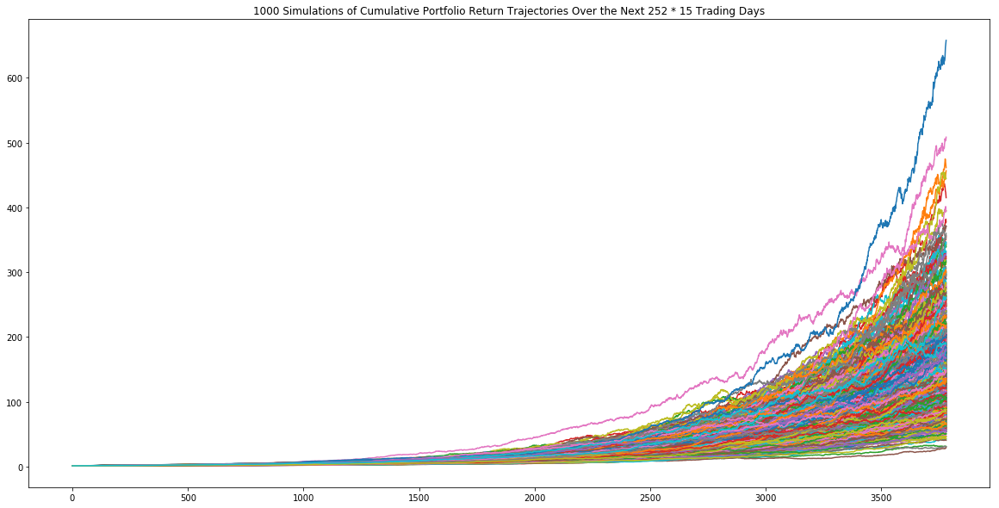

In [20]:
# Use the `plot` function to plot `1000` simulations of the potential trajectories of the portfolio based on 252 * 15 trading days
plot_title = f"{n+1} Simulations of Cumulative Portfolio Return Trajectories Over the Next 252 * 15 Trading Days"
portfolio_cumulative_returns.plot(legend=None, title=plot_title,figsize=(20,10))

## Research Question 3:

### Portfolio Volatility

This section can be used to accompany the risk analysis of the portfolio

In [21]:
# Calculate the portfolio's volatility to compare against the S&P 500
profitable_portfolio_volatility = portfolio_cumulative_returns.std()

# Display the portfolio volatility
profitable_portfolio_volatility

0      30.158435
1      51.845657
2      56.681398
3      36.590869
4      34.008352
         ...    
995    17.133310
996    36.436319
997    25.604528
998    21.558199
999    56.881848
Length: 1000, dtype: float64

In [22]:
# Stocks that have a greater volatility than the S&P 500
cumulative_returns['SPY'].std() < profitable_portfolio_volatility

0      True
1      True
2      True
3      True
4      True
       ... 
995    True
996    True
997    True
998    True
999    True
Length: 1000, dtype: bool

#### Stocks in the Profitable Portfolio with greater risk than the S&P 500

90% of the Profitable Portfolio stocks have a higher volatility than the S&P 500 (tickers: MKTX, TDY, NFLX, SPGI, IPGP, MSCI, NOW, BIO, AMZN)

In [23]:
# Calculate the rolling volatility over a 120 day day window
portfolio_rolling_volatility = portfolio_daily_returns.rolling(window=120).std()

# Display the data
portfolio_rolling_volatility.tail()


3776    0.008027
3777    0.008026
3778    0.007989
3779    0.008023
3780    0.008030
dtype: float64

In [26]:
# Create a line chart display the data using hvPlot
rolling_volatility_hvplot = portfolio_rolling_volatility.hvplot(label="Rolling Portfolio Volatility",
                                                                legend=True,
                                                                height=500,
                                                                width=900)



# Display the plot
rolling_volatility_hvplot



:Curve   [index]   (0)

#### Portfolio volatility reaction

Based on a 120 day rolling standard deviaition, it appears the volatiltiy for the stocks in the Profitable Portfolio follow the market volatility.  

### Sharpe Ratio and Sortino Ratio Calculation

#### Sharpe Ratio Analysis for the individual portfolio stocks

In [30]:
# Calculate annualized Sharpe Ratios
sharpe_ratios = (top_prof_stock_prices_df.mean() * 252) / (top_prof_stock_prices_df.std() * np.sqrt(252))
#savings results into a dataframe
df_sharpe_ratios = pd.DataFrame({'stock':sharpe_ratios.index, 'sharpe_ratio':sharpe_ratios.values})

print(df_sharpe_ratios)

stock  sharpe_ratio
0    SPY    106.787789
1   MKTX     34.884803
2    PNC     81.758430
3    TDY     35.051004
4   NFLX     32.681965
5   SPGI     42.617699
6   IPGP     44.794375
7   MSCI     30.451131
8    NOW     28.074362
9    BIO     44.149173
10  AMZN     35.585447


In [31]:
#Graphing sharpe ratios
fig = px.bar(df_sharpe_ratios,x='stock', y='sharpe_ratio', title="Sharpe Ratios for Profitable Portfolio")
fig.show()

In [32]:
#calculating negative portfolio returns for sortino ratio
negative_portfolio_returns = portfolio_daily_returns.where(lambda x : x < 0).dropna()
negative_portfolio_returns.head()

portfolio_down_std = negative_portfolio_returns.std()
print(portfolio_down_std)

0.004117307555896022


#### Portfolio's Sharpe Ratio and Sortino Ratio

In [33]:
risk_free_rate = 0.0275
sortino_ratio = (portfolio_daily_returns.mean() - risk_free_rate) / portfolio_down_std
sharpe_ratio = (portfolio_daily_returns.mean() - risk_free_rate) / portfolio_daily_returns.std()

##Sortin
print(f"Sortino ratio is {sortino_ratio}")
print(f"Sharpe ratio is {sharpe_ratio}")

Sortino ratio is -6.315379942724438
Sharpe ratio is -3.5040078042779865


### Moving Average for Amazon 

This section provides a better understanding how the algorithm works to determine the ten most profitable stocks from the S&P 500.

In [34]:
# Import the amazon csv 
amzn_df = Path("resources/sample_moving_amzn.csv")
amzn_df = pd.read_csv(amzn_df)

# Display the df
amzn_df.head()

,date,close,50ma,100ma
0,2015-07-27,531.41,531.410000,531.410000
1,2015-07-28,526.03,528.720000,528.720000
2,2015-07-29,529.00,528.813333,528.813333
3,2015-07-30,536.76,530.800000,530.800000
4,2015-07-31,536.15,531.870000,531.870000


In [35]:
# Create an hv line plot
amzn_df.hvplot()

:NdOverlay   [Variable]
   :Curve   [index]   (value)

In [36]:
# Create a plotly express line plot 

# First, manipulate the original amzn_df using the pd.melt function
amzn_new_df = pd.melt(amzn_df, id_vars=['date'], value_vars=['close', '50ma', '100ma'])

# Plot the px line figure 
amzn_pxlineplot = px.line(amzn_new_df, 
                          x='date', 
                          y='value', 
                          color='variable')

amzn_pxlineplot.show()
